In [137]:
import pandas as pd
import folium

df = pd.read_csv("accidents-velos.csv", low_memory=False)

In [133]:
# nettoyage de la donnée : on supprime toutes les lignes dont la longitude ou latitude est nulle
df_loc = df
df_loc = df_loc.dropna(subset="lat")
df_loc = df_loc.dropna(subset="lon")

m = folium.Map(width = 1500, height = 1500, location=[46.5, 2.5])

for i in range(df_loc.shape[0]):#nombre de lignes
 nom_lieu=df_loc.iloc[i,6]
 lat=float(df_loc.iloc[i,7])
 long=float(df_loc.iloc[i,8])
 folium.Circle(location = [lat, long], radius = 0.5, color = "#3186cc").add_to(m)

m

# on voit bien que la plupart des accidents ont lieu dans de grandes agglomérations

<AxesSubplot:ylabel='Frequency'>

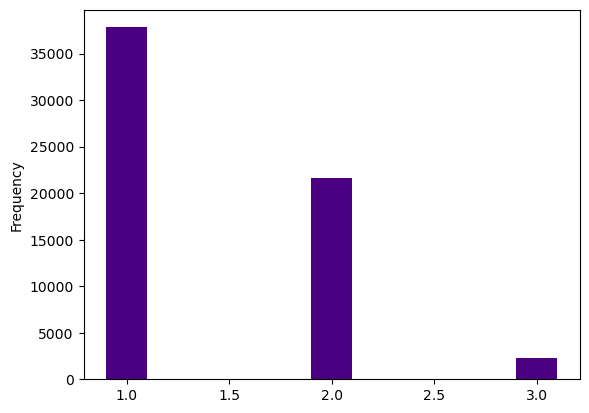

In [138]:
# nettoyage de la donnée pour récupérer la gravité d'un accident
df['gravite'] = df['gravite accident'].str[0]
df['gravite'] = df['gravite'].astype(int)

df['gravite'].plot.hist(bins = 3, rwidth = 0.2, range=(0.5, 3.5), color = 'indigo')

# nombre d'accidents en fonction de la gravité
# 1 - blessure légère
# 2 - blessure hospitalisation
# 3 - mort

Text(0.5, 1.0, 'Fréquence en fonction du jour de la semaine')

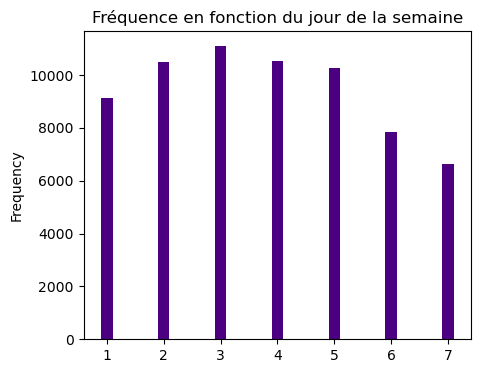

In [139]:
# nettoyage de la donnée pour récupérer le jour de l'accident
df['doa'] = df['jour'].str[0]
df['doa'] = df['doa'].astype(int) + 1

df['doa'].plot.hist(bins = 7, rwidth = 0.2, range=(0.5, 7.5), color = 'indigo', figsize = (5,4))

plt.title("Fréquence en fonction du jour de la semaine",fontsize=12)
# nombre d'accidents en fonction du jour de la semaine
# 1 - lundi
# 2 - mardi
# 3 - mercredi
# 4 - jeudi
# 5 - vendredi
# 6 - samedi
# 7 - dimanche

Text(0.5, 1.0, 'Heatmap of amounts of accidents per day of months every year')

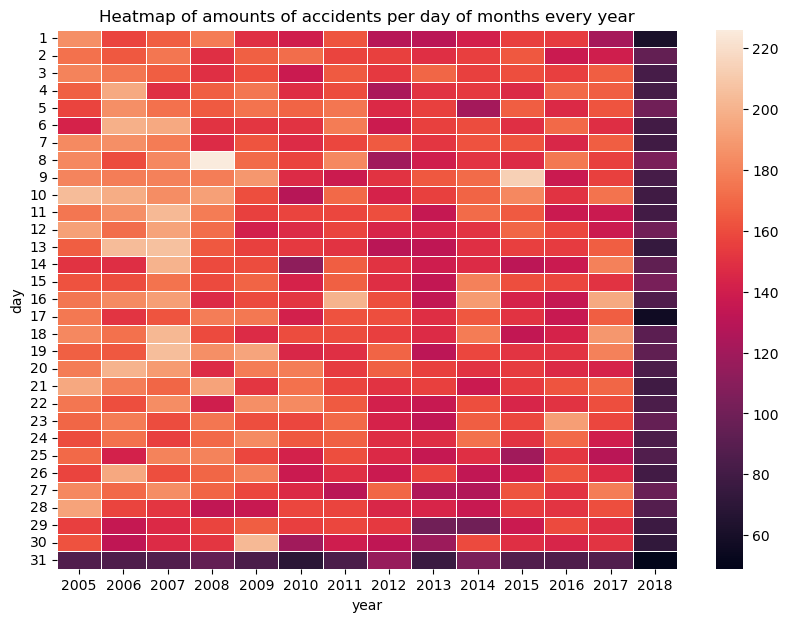

In [140]:
import seaborn as sns
import matplotlib.pyplot as plt

# nettoyage des données : récupération dans les colonnes year et day les années et jour du mois
df['year'] = df['date'].str[0:4]
df['year'] = df['year'].astype(int)

df['day'] = df['date'].str[8:10]
df['day'] = df['day'].astype(int)

def count_rows(rows):
    return len(rows)

# la heatmap représente le nombre d'accidents les jours de mois par année : ça fait une cumulation sur tous les 1 de 
# chaque mois, puis sur le 2, etc... jusqu'au 31 de chaque mois et c'est combiné par année.
heatmap = df.groupby(['day','year']).apply(count_rows).unstack()
heatmap = heatmap.fillna(0)
plt.figure(figsize = (10, 7))
sns.heatmap(heatmap, linewidths=0.5)
plt.title('Heatmap of amounts of accidents per day of months every year')

# observation intéressante, il semblerait y avoir moins d'accidents au fur et à mesure des années

gravite
0    AxesSubplot(0.125,0.11;0.775x0.77)
1    AxesSubplot(0.125,0.11;0.775x0.77)
2    AxesSubplot(0.125,0.11;0.775x0.77)
3    AxesSubplot(0.125,0.11;0.775x0.77)
Name: luminosite, dtype: object

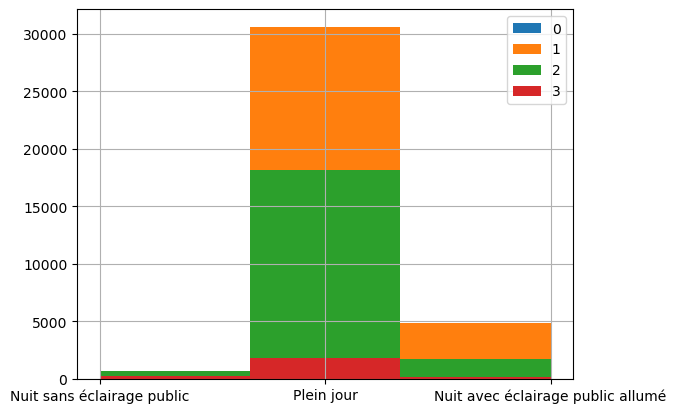

In [141]:
df.groupby('gravite')['luminosite'].hist(legend=True, range=(0, 2), bins = 3)

# peu d'accidents globalement lors de la nuit avec éclairage public et encore moins sans éclairage
# => surprenant, les gens sont bcp plus vigilants la nuit et font moins attention au danger bcp plus
# présent en journée

Text(0.5, 1.0, "Nombre d'accidents en fonction de la localisation, décrit par la gravité")

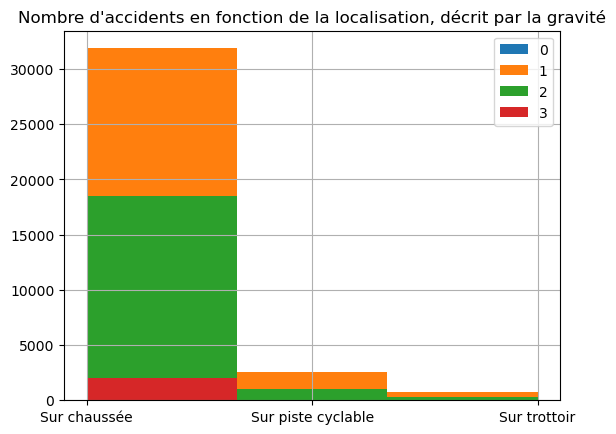

In [142]:
df.groupby('gravite')['situation'].hist(legend=True, range=(0, 2), bins = 3)

plt.title("Nombre d'accidents en fonction de la localisation, décrit par la gravité",fontsize=12)

# la plupart des accidents arrivent sur chaussée, la gravité des accidents reste faible proportionnellement parlant
# piste de solution => mettre plus de pistes cyclables à disposition

gravite
0    AxesSubplot(0.125,0.11;0.775x0.77)
1    AxesSubplot(0.125,0.11;0.775x0.77)
2    AxesSubplot(0.125,0.11;0.775x0.77)
3    AxesSubplot(0.125,0.11;0.775x0.77)
Name: trace plan route, dtype: object

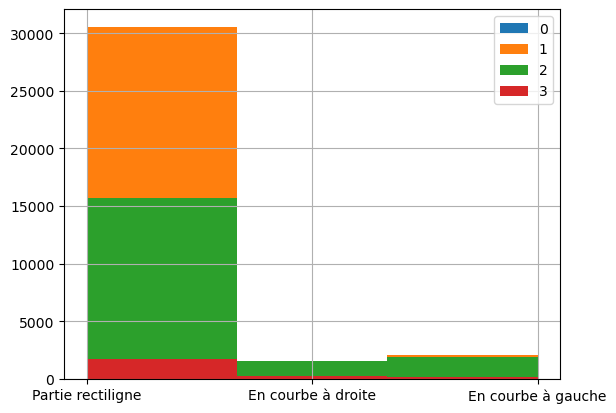

In [143]:
df.groupby('gravite')['trace plan route'].hist(legend=True, range=(0, 2), bins = 3)

Text(0, 0.5, 'Fréquence')

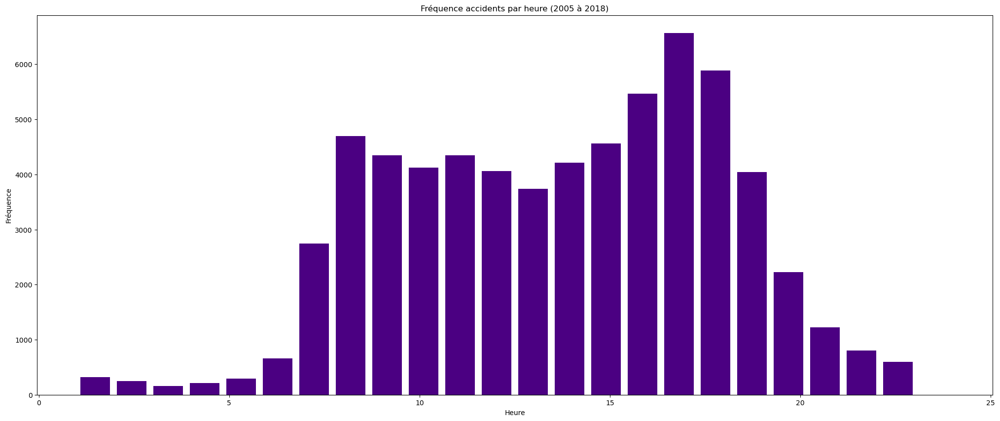

In [144]:
plt.figure(figsize = (25, 10))
plt.title('Fréquence accidents par heure (2005 à 2018)')
df['heure'].plot.hist(bins = 24, rwidth = 0.8, range=(1, 24), color = 'indigo')
plt.xlabel('Heure')
plt.ylabel('Fréquence')

# plus d'accidents vers le matin et encore plus vers le soir 
# => quand les gens sortent du travail le soir ils sont pressés de rentrer chez eux et font moins attention
# => il faut installer + de pistes cyclabes dans les grandes villes pour sécuriser les cyclistes

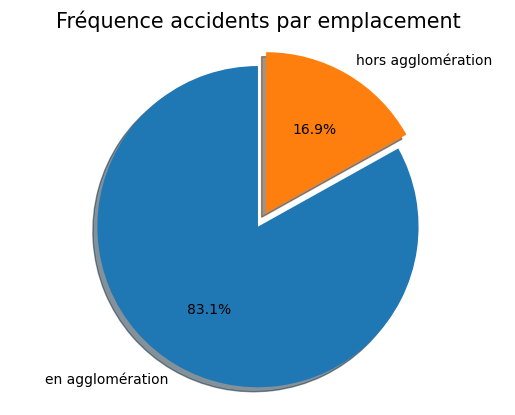

In [145]:
test = df.groupby(['en agglomeration']).apply(count_rows)
test

labels = 'en agglomération', 'hors agglomération'
sizes = [test['oui'], test['non']]
explode = (0.1,0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.title('Fréquence accidents par emplacement',fontsize=15)
plt.show()

gravite
0    AxesSubplot(0.125,0.11;0.775x0.77)
1    AxesSubplot(0.125,0.11;0.775x0.77)
2    AxesSubplot(0.125,0.11;0.775x0.77)
3    AxesSubplot(0.125,0.11;0.775x0.77)
Name: old, dtype: object

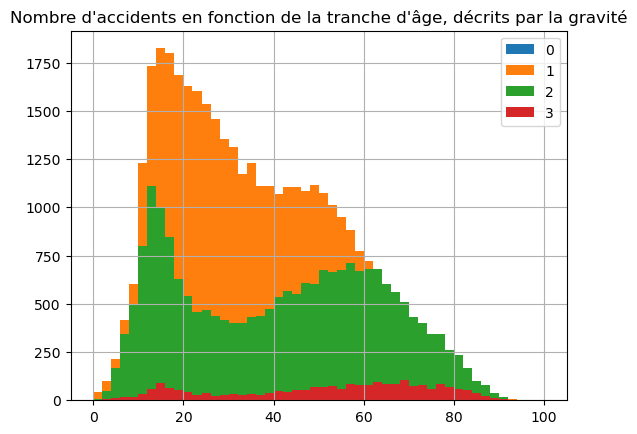

In [146]:
def get_age(string):
    string = str(string)
    if string[1] == '-':
        return string[0]
    else:
        return string
    
df['old'] = df['age'].str[0:2]
df['old'] = df['old'].map(get_age)
df = df.dropna(subset='old')
df['old'] = df['old'].astype(float)

plt.title("Nombre d'accidents en fonction de la tranche d'âge, décrits par la gravité",fontsize=12);
df.groupby('gravite')['old'].hist(legend=True, range=(0, 100), bins = 50)

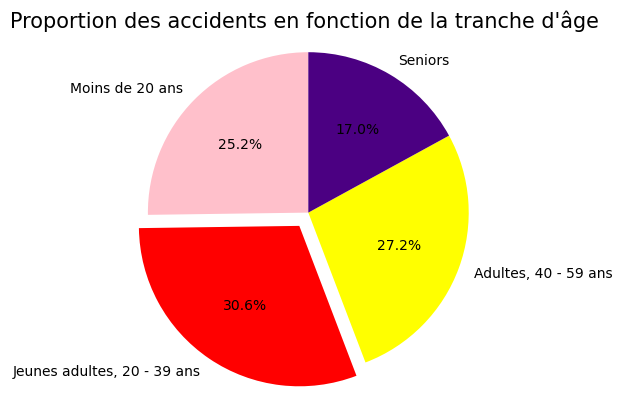

In [152]:
def tranche_age(string):
    if string < 20:
        return "Moins de 20 ans"
    elif string < 40:
        return "Jeunes adultes, 20 - 39 ans"
    elif string < 60:
        return "Adultes, 40 - 59 ans"
    else :
        return "Seniors"
    
df["tranche_age"] = df["old"].apply(tranche_age)
df["tranche_age"]

tranche_age = df.groupby(["tranche_age"]).count()
tranche_age["date"]

labels = "Moins de 20 ans", "Jeunes adultes, 20 - 39 ans", "Adultes, 40 - 59 ans", "Seniors"
sizes = [tranche_age["date"]["Moins de 20 ans"], tranche_age["date"]["Jeunes adultes, 20 - 39 ans"], tranche_age["date"]["Adultes, 40 - 59 ans"], tranche_age["date"]["Seniors"]]
explode = (0,0.1,0,0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode = explode, autopct='%1.1f%%', startangle=90, colors = ['pink', 'red', 'yellow', 'indigo'])
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.title("Proportion des accidents en fonction de la tranche d'âge",fontsize=15)
plt.show()

